In [39]:
import sys
!{sys.executable} -m pip install -q pandas


[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: python3.10 -m pip install --upgrade pip


In [1]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow_docs.vis import embed
import numpy as np
import cv2

# Import matplotlib libraries
from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection
import matplotlib.patches as patches
import pandas as pd

# Some modules to display an animation using imageio.
import imageio
from IPython.display import HTML, display

2023-06-08 14:59:55.727319: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
#@title Helper functions for visualization

# Dictionary that maps from joint names to keypoint indices.
KEYPOINT_DICT = {
    'nose': 0,
    'left_eye': 1,
    'right_eye': 2,
    'left_ear': 3,
    'right_ear': 4,
    'left_shoulder': 5,
    'right_shoulder': 6,
    'left_elbow': 7,
    'right_elbow': 8,
    'left_wrist': 9,
    'right_wrist': 10,
    'left_hip': 11,
    'right_hip': 12,
    'left_knee': 13,
    'right_knee': 14,
    'left_ankle': 15,
    'right_ankle': 16
}

# Maps bones to a matplotlib color name.
KEYPOINT_EDGE_INDS_TO_COLOR = {
    (0, 1): 'm',
    (0, 2): 'c',
    (1, 3): 'm',
    (2, 4): 'c',
    (0, 5): 'm',
    (0, 6): 'c',
    (5, 7): 'm',
    (7, 9): 'm',
    (6, 8): 'c',
    (8, 10): 'c',
    (5, 6): 'y',
    (5, 11): 'm',
    (6, 12): 'c',
    (11, 12): 'y',
    (11, 13): 'm',
    (13, 15): 'm',
    (12, 14): 'c',
    (14, 16): 'c'
}

def _keypoints_and_edges_for_display(keypoints_with_scores,
                                     height,
                                     width,
                                     keypoint_threshold=0.11):
  """Returns high confidence keypoints and edges for visualization.

  Args:
    keypoints_with_scores: A numpy array with shape [1, 1, 17, 3] representing
      the keypoint coordinates and scores returned from the MoveNet model.
    height: height of the image in pixels.
    width: width of the image in pixels.
    keypoint_threshold: minimum confidence score for a keypoint to be
      visualized.

  Returns:
    A (keypoints_xy, edges_xy, edge_colors) containing:
      * the coordinates of all keypoints of all detected entities;
      * the coordinates of all skeleton edges of all detected entities;
      * the colors in which the edges should be plotted.
  """
  keypoints_all = []
  keypoint_edges_all = []
  edge_colors = []
  num_instances, _, _, _ = keypoints_with_scores.shape
  for idx in range(num_instances):
    kpts_x = keypoints_with_scores[0, idx, :, 1]
    kpts_y = keypoints_with_scores[0, idx, :, 0]
    kpts_scores = keypoints_with_scores[0, idx, :, 2]
    kpts_absolute_xy = np.stack(
        [width * np.array(kpts_x), height * np.array(kpts_y)], axis=-1)
    kpts_above_thresh_absolute = kpts_absolute_xy[
        kpts_scores > keypoint_threshold, :]
    keypoints_all.append(kpts_above_thresh_absolute)

    for edge_pair, color in KEYPOINT_EDGE_INDS_TO_COLOR.items():
      if (kpts_scores[edge_pair[0]] > keypoint_threshold and
          kpts_scores[edge_pair[1]] > keypoint_threshold):
        x_start = kpts_absolute_xy[edge_pair[0], 0]
        y_start = kpts_absolute_xy[edge_pair[0], 1]
        x_end = kpts_absolute_xy[edge_pair[1], 0]
        y_end = kpts_absolute_xy[edge_pair[1], 1]
        line_seg = np.array([[x_start, y_start], [x_end, y_end]])
        keypoint_edges_all.append(line_seg)
        edge_colors.append(color)
  if keypoints_all:
    keypoints_xy = np.concatenate(keypoints_all, axis=0)
  else:
    keypoints_xy = np.zeros((0, 17, 2))

  if keypoint_edges_all:
    edges_xy = np.stack(keypoint_edges_all, axis=0)
  else:
    edges_xy = np.zeros((0, 2, 2))
  return keypoints_xy, edges_xy, edge_colors


def draw_prediction_on_image(
    image, keypoints_with_scores, crop_region=None, close_figure=False,
    output_image_height=None):
  """Draws the keypoint predictions on image.

  Args:
    image: A numpy array with shape [height, width, channel] representing the
      pixel values of the input image.
    keypoints_with_scores: A numpy array with shape [1, 1, 17, 3] representing
      the keypoint coordinates and scores returned from the MoveNet model.
    crop_region: A dictionary that defines the coordinates of the bounding box
      of the crop region in normalized coordinates (see the init_crop_region
      function below for more detail). If provided, this function will also
      draw the bounding box on the image.
    output_image_height: An integer indicating the height of the output image.
      Note that the image aspect ratio will be the same as the input image.

  Returns:
    A numpy array with shape [out_height, out_width, channel] representing the
    image overlaid with keypoint predictions.
  """
  height, width, channel = image.shape
  aspect_ratio = float(width) / height
  fig, ax = plt.subplots(figsize=(12 * aspect_ratio, 12))
  # print("height, width, channel", height, width, channel)
  # To remove the huge white borders
  fig.tight_layout(pad=0)
  ax.margins(0)
  ax.set_yticklabels([])
  ax.set_xticklabels([])
  plt.axis('off')

  im = ax.imshow(image)
  line_segments = LineCollection([], linewidths=(4), linestyle='solid')
  ax.add_collection(line_segments)
  # Turn off tick labels
  scat = ax.scatter([], [], s=60, color='#FF1493', zorder=3)

  (keypoint_locs, keypoint_edges,
   edge_colors) = _keypoints_and_edges_for_display(
       keypoints_with_scores, height, width)

  line_segments.set_segments(keypoint_edges)
  line_segments.set_color(edge_colors)
  if keypoint_edges.shape[0]:
    line_segments.set_segments(keypoint_edges)
    line_segments.set_color(edge_colors)
  if keypoint_locs.shape[0]:
    scat.set_offsets(keypoint_locs)

  if crop_region is not None:
    # print("nonzero crop region")
    xmin = max(crop_region['x_min'] * width, 0.0)
    ymin = max(crop_region['y_min'] * height, 0.0)
    rec_width = min(crop_region['x_max'], 0.99) * width - xmin
    rec_height = min(crop_region['y_max'], 0.99) * height - ymin
    rect = patches.Rectangle(
        (xmin,ymin),rec_width,rec_height,
        linewidth=1,edgecolor='b',facecolor='none')
    ax.add_patch(rect)

  fig.canvas.draw()
  image_from_plot = np.frombuffer(fig.canvas.tostring_rgb(), dtype=np.uint8)
  # print("image_from_plot.shape: ", image_from_plot.shape)
  image_from_plot = image_from_plot.reshape(
      fig.canvas.get_width_height()[::-1] + (3,))
  plt.close(fig)
  if output_image_height is not None:
    output_image_width = int(output_image_height / height * width)
    image_from_plot = cv2.resize(
        image_from_plot, dsize=(output_image_width, output_image_height),
         interpolation=cv2.INTER_CUBIC)
  # print(image_from_plot.shape)
  return image_from_plot

def to_gif(images, duration):
  """Converts image sequence (4D numpy array) to gif."""
  imageio.mimsave('./animation.gif', images, duration=duration)
  return embed.embed_file('./animation.gif')

def progress(value, max=100):
  return HTML("""
      <progress
          value='{value}'
          max='{max}',
          style='width: 100%'
      >
          {value}
      </progress>
  """.format(value=value, max=max))

## Load MoveNet model

In [8]:
model_name = [
    'movenet_thunder',
    # 'movenet_lightning',
]

if "movenet_lightning" in model_name:
    module = hub.load("https://tfhub.dev/google/movenet/singlepose/lightning/4")
    input_size = 192
elif "movenet_thunder" in model_name:
    module = hub.load("https://tfhub.dev/google/movenet/singlepose/thunder/4")
    input_size = 256
else:
    raise ValueError("Unsupported model name: %s" % model_name)

def movenet(input_image):
    """Runs detection on an input image.

    Args:
        input_image: A [1, height, width, 3] tensor represents the input image
        pixels. Note that the height/width should already be resized and match the
        expected input resolution of the model before passing into this function.

    Returns:
        A [1, 1, 17, 3] float numpy array representing the predicted keypoint
        coordinates and scores.
    """
    model = module.signatures['serving_default']

    # SavedModel format expects tensor type of int32.
    input_image = tf.cast(input_image, dtype=tf.int32)
    # Run model inference.
    outputs = model(input_image)
    # Output is a [1, 1, 17, 3] tensor.
    keypoints_with_scores = outputs['output_0'].numpy()
    return keypoints_with_scores

## Read in video file

In [9]:
mcl_video_file = '/Users/ilonademler/Documents/Harvard/seniorfall/coral/mcl_experiments/mcl_data/MCL_4_14/videos/test.mp4'

cap = cv2.VideoCapture(mcl_video_file)

if (cap.isOpened()== False): 
  print("Error opening video stream or file")

frame_count = 0

while(cap.isOpened()):
  ret, frame = cap.read()
  frame = np.expand_dims(frame, axis=0)
  frame_count += 1
  if ret == True:
    if frame_count == 1:
      frames = frame
    else:
      frames = np.concatenate((frames, frame), axis=0)
  else:
    break

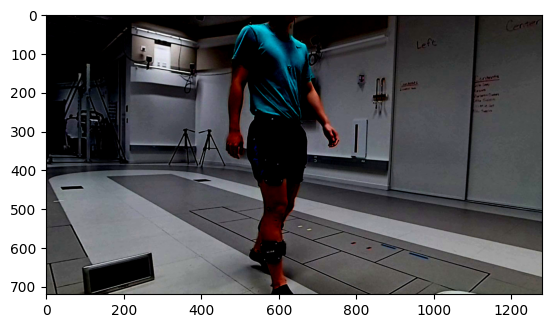

In [19]:
input_img = frames[-1]
input_img = cv2.cvtColor(input_img, cv2.COLOR_BGR2RGB).astype(np.float32)
input_img = input_img * (2.0 / 255.0) - 1.0
plt.imshow(input_img)

## Analyze a Video

In [22]:
keypoints = ['NOSE', 'LEFT_EYE', 'RIGHT_EYE', 'LEFT_EAR', 'RIGHT_EAR', 
             'LEFT_SHOULDER', 'RIGHT_SHOULDER', 'LEFT_ELBOW', 
             'RIGHT_ELBOW', 'LEFT_WRIST', 'RIGHT_WRIST', 'LEFT_HIP', 
             'RIGHT_HIP', 'LEFT_KNEE', 'RIGHT_KNEE', 'LEFT_ANKLE', 
             'RIGHT_ANKLE']

# indeces of keypoints between which we want to draw a line
num_edges = ((0, 1),(0, 2),(0, 3),(0, 4),(3, 1),(4, 2),
             (1, 2),(5, 6),(5, 7),(5, 11),(6, 8),(6, 12),
             (7, 9),(8, 10),(11, 12),(11, 13),(12, 14),
             (13, 15),(14, 16),)

# same list but as keypoint names 
EDGES = (
    ('NOSE', 'LEFT_EYE'),
    ('NOSE', 'RIGHT_EYE'),
    ('NOSE', 'LEFT_EAR'),
    ('NOSE', 'RIGHT_EAR'),
    ('LEFT_EAR', 'LEFT_EYE'),
    ('RIGHT_EAR', 'RIGHT_EYE'),
    ('LEFT_EYE', 'RIGHT_EYE'),
    ('LEFT_SHOULDER', 'RIGHT_SHOULDER'),
    ('LEFT_SHOULDER', 'LEFT_ELBOW'),
    ('LEFT_SHOULDER', 'LEFT_HIP'),
    ('RIGHT_SHOULDER', 'RIGHT_ELBOW'),
    ('RIGHT_SHOULDER', 'RIGHT_HIP'),
    ('LEFT_ELBOW', 'LEFT_WRIST'),
    ('RIGHT_ELBOW', 'RIGHT_WRIST'),
    ('LEFT_HIP', 'RIGHT_HIP'),
    ('LEFT_HIP', 'LEFT_KNEE'),
    ('RIGHT_HIP', 'RIGHT_KNEE'),
    ('LEFT_KNEE', 'LEFT_ANKLE'),
    ('RIGHT_KNEE', 'RIGHT_ANKLE'),
)

In [21]:
#@title Cropping Algorithm

# Confidence score to determine whether a keypoint prediction is reliable.
MIN_CROP_KEYPOINT_SCORE = 0.2

def init_crop_region(image_height, image_width):
  """Defines the default crop region.

  The function provides the initial crop region (pads the full image from both
  sides to make it a square image) when the algorithm cannot reliably determine
  the crop region from the previous frame.
  """
  if image_width > image_height:
    box_height = image_width / image_height
    box_width = 1.0
    y_min = (image_height / 2 - image_width / 2) / image_height
    x_min = 0.0
  else:
    box_height = 1.0
    box_width = image_height / image_width
    y_min = 0.0
    x_min = (image_width / 2 - image_height / 2) / image_width

  return {
    'y_min': y_min,
    'x_min': x_min,
    'y_max': y_min + box_height,
    'x_max': x_min + box_width,
    'height': box_height,
    'width': box_width
  }

def torso_visible(keypoints):
  """Checks whether there are enough torso keypoints.

  This function checks whether the model is confident at predicting one of the
  shoulders/hips which is required to determine a good crop region.
  """
  return ((keypoints[0, 0, KEYPOINT_DICT['left_hip'], 2] >
           MIN_CROP_KEYPOINT_SCORE or
          keypoints[0, 0, KEYPOINT_DICT['right_hip'], 2] >
           MIN_CROP_KEYPOINT_SCORE) and
          (keypoints[0, 0, KEYPOINT_DICT['left_shoulder'], 2] >
           MIN_CROP_KEYPOINT_SCORE or
          keypoints[0, 0, KEYPOINT_DICT['right_shoulder'], 2] >
           MIN_CROP_KEYPOINT_SCORE))

def determine_torso_and_body_range(
    keypoints, target_keypoints, center_y, center_x):
  """Calculates the maximum distance from each keypoints to the center location.

  The function returns the maximum distances from the two sets of keypoints:
  full 17 keypoints and 4 torso keypoints. The returned information will be
  used to determine the crop size. See determineCropRegion for more detail.
  """
  torso_joints = ['left_shoulder', 'right_shoulder', 'left_hip', 'right_hip']
  max_torso_yrange = 0.0
  max_torso_xrange = 0.0
  for joint in torso_joints:
    dist_y = abs(center_y - target_keypoints[joint][0])
    dist_x = abs(center_x - target_keypoints[joint][1])
    if dist_y > max_torso_yrange:
      max_torso_yrange = dist_y
    if dist_x > max_torso_xrange:
      max_torso_xrange = dist_x

  max_body_yrange = 0.0
  max_body_xrange = 0.0
  for joint in KEYPOINT_DICT.keys():
    if keypoints[0, 0, KEYPOINT_DICT[joint], 2] < MIN_CROP_KEYPOINT_SCORE:
      continue
    dist_y = abs(center_y - target_keypoints[joint][0]);
    dist_x = abs(center_x - target_keypoints[joint][1]);
    if dist_y > max_body_yrange:
      max_body_yrange = dist_y

    if dist_x > max_body_xrange:
      max_body_xrange = dist_x

  return [max_torso_yrange, max_torso_xrange, max_body_yrange, max_body_xrange]

def determine_crop_region(
      keypoints, image_height,
      image_width):
  """Determines the region to crop the image for the model to run inference on.

  The algorithm uses the detected joints from the previous frame to estimate
  the square region that encloses the full body of the target person and
  centers at the midpoint of two hip joints. The crop size is determined by
  the distances between each joints and the center point.
  When the model is not confident with the four torso joint predictions, the
  function returns a default crop which is the full image padded to square.
  """
  target_keypoints = {}
  for joint in KEYPOINT_DICT.keys():
    target_keypoints[joint] = [
      keypoints[0, 0, KEYPOINT_DICT[joint], 0] * image_height,
      keypoints[0, 0, KEYPOINT_DICT[joint], 1] * image_width
    ]

  if torso_visible(keypoints):
    center_y = (target_keypoints['left_hip'][0] +
                target_keypoints['right_hip'][0]) / 2;
    center_x = (target_keypoints['left_hip'][1] +
                target_keypoints['right_hip'][1]) / 2;

    (max_torso_yrange, max_torso_xrange,
      max_body_yrange, max_body_xrange) = determine_torso_and_body_range(
          keypoints, target_keypoints, center_y, center_x)

    crop_length_half = np.amax(
        [max_torso_xrange * 1.9, max_torso_yrange * 1.9,
          max_body_yrange * 1.2, max_body_xrange * 1.2])

    tmp = np.array(
        [center_x, image_width - center_x, center_y, image_height - center_y])
    crop_length_half = np.amin(
        [crop_length_half, np.amax(tmp)]);

    crop_corner = [center_y - crop_length_half, center_x - crop_length_half];

    if crop_length_half > max(image_width, image_height) / 2:
      return init_crop_region(image_height, image_width)
    else:
      crop_length = crop_length_half * 2;
      return {
        'y_min': crop_corner[0] / image_height,
        'x_min': crop_corner[1] / image_width,
        'y_max': (crop_corner[0] + crop_length) / image_height,
        'x_max': (crop_corner[1] + crop_length) / image_width,
        'height': (crop_corner[0] + crop_length) / image_height -
            crop_corner[0] / image_height,
        'width': (crop_corner[1] + crop_length) / image_width -
            crop_corner[1] / image_width
      }
  else:
    return init_crop_region(image_height, image_width)

def crop_and_resize(image, crop_region, crop_size):
  """Crops and resize the image to prepare for the model input."""
  boxes=[[crop_region['y_min'], crop_region['x_min'],
          crop_region['y_max'], crop_region['x_max']]]
  output_image = tf.image.crop_and_resize(
      image, box_indices=[0], boxes=boxes, crop_size=crop_size)
  return output_image

def run_inference(movenet, image, crop_region, crop_size):
  """Runs model inferece on the cropped region.

  The function runs the model inference on the cropped region and updates the
  model output to the original image coordinate system.
  """
  image_height, image_width, _ = image.shape
  input_image = crop_and_resize(
    tf.expand_dims(image, axis=0), crop_region, crop_size=crop_size)
  # Run model inference.
  keypoints_with_scores = movenet(input_image)
  # Update the coordinates.
  for idx in range(17):
    keypoints_with_scores[0, 0, idx, 0] = (
        crop_region['y_min'] * image_height +
        crop_region['height'] * image_height *
        keypoints_with_scores[0, 0, idx, 0]) / image_height
    keypoints_with_scores[0, 0, idx, 1] = (
        crop_region['x_min'] * image_width +
        crop_region['width'] * image_width *
        keypoints_with_scores[0, 0, idx, 1]) / image_width
  return keypoints_with_scores

## Keypoint animation + save keypoint df

In [29]:
(frames[:50,]).shape

(50, 720, 1280, 3)

In [57]:
# image = tf.convert_to_tensor(frames[:50])
image = tf.convert_to_tensor(frames)


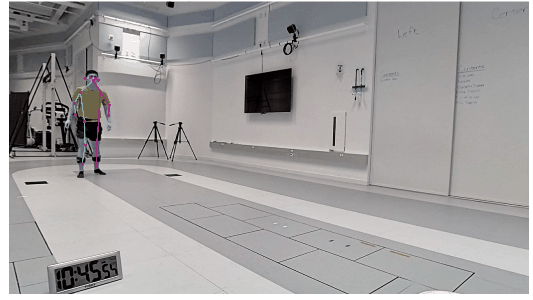

In [58]:
def pose_dict_from_kps(keypoints_with_scores):
    pose_dict = {}
    for i in range(17):
        pose_dict[keypoints[i]] = keypoints_with_scores[0,0,i]
    return pose_dict

def update_kp_dict(pose_dict, kp_df):
    for key in pose_dict.keys():
        pose_dict[key].append(kp_df[key])
        # kp_df.loc[key] = pose_dict[key]
    return pose_dict

def create_kp_dict(keyopints):
    kp_df = {}
    for key in keypoints:
        kp_df[key] = []
    return kp_df

# Load the input image.
num_frames, image_height, image_width, _ = image.shape
crop_region = init_crop_region(image_height, image_width)

output_images = []
kp_dict = create_kp_dict(keypoints)

bar = display(progress(0, num_frames-1), display_id=True)
for frame_idx in range(num_frames):
  keypoints_with_scores = run_inference(
      movenet, image[frame_idx, :, :, :], crop_region,
      crop_size=[input_size, input_size])

  output_images.append(draw_prediction_on_image(
      image[frame_idx, :, :, :].numpy().astype(np.int32),
      keypoints_with_scores, crop_region=None,
      close_figure=True, output_image_height=300))
  crop_region = determine_crop_region(
      keypoints_with_scores, image_height, image_width)
  bar.update(progress(frame_idx, num_frames-1))

  kp_df = update_kp_dict(kp_dict, pose_dict_from_kps(keypoints_with_scores))

# Prepare gif visualization.
output = np.stack(output_images, axis=0)
to_gif(output, duration=100)

In [59]:
# create dataframe 

kp_df = pd.DataFrame(kp_dict, columns=keypoints)

{'NOSE': array([0.26537126, 0.16081579, 0.8274974 ], dtype=float32),
 'LEFT_EYE': array([0.259519  , 0.16486584, 0.7818698 ], dtype=float32),
 'RIGHT_EYE': array([0.25893447, 0.15634778, 0.8961448 ], dtype=float32),
 'LEFT_EAR': array([0.26640552, 0.1695154 , 0.82918924], dtype=float32),
 'RIGHT_EAR': array([0.26705605, 0.14875206, 0.7839573 ], dtype=float32),
 'LEFT_SHOULDER': array([0.31288496, 0.18040276, 0.946245  ], dtype=float32),
 'RIGHT_SHOULDER': array([0.3006492 , 0.13565296, 0.94840604], dtype=float32),
 'LEFT_ELBOW': array([0.3690484 , 0.18752776, 0.8813569 ], dtype=float32),
 'RIGHT_ELBOW': array([0.35504535, 0.12385618, 0.9019954 ], dtype=float32),
 'LEFT_WRIST': array([0.41591907, 0.1918408 , 0.71766305], dtype=float32),
 'RIGHT_WRIST': array([0.40338218, 0.11481998, 0.9019116 ], dtype=float32),
 'LEFT_HIP': array([0.41065127, 0.1655867 , 0.91680306], dtype=float32),
 'RIGHT_HIP': array([0.4068856 , 0.1404303 , 0.81296796], dtype=float32),
 'LEFT_KNEE': array([0.4990566 

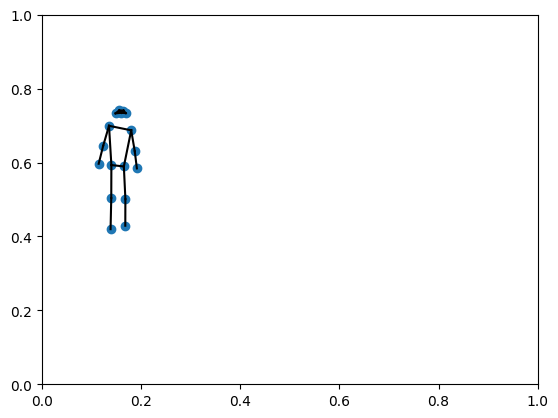

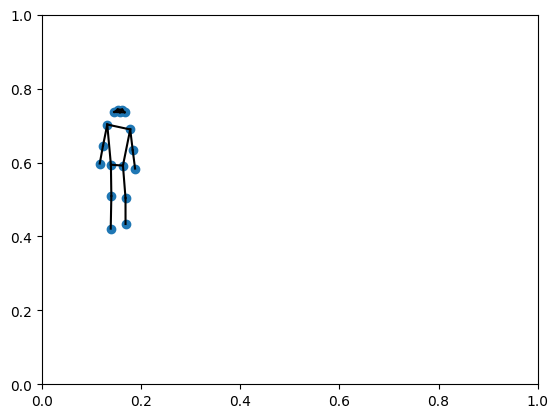

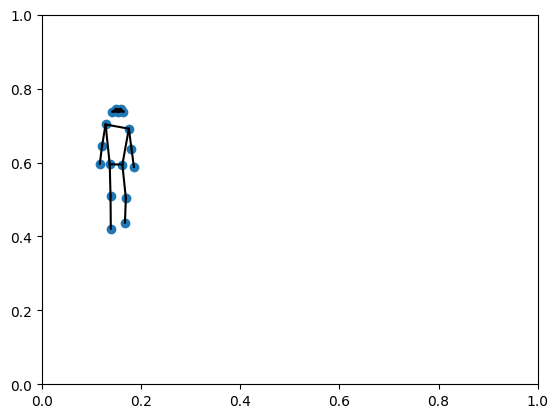

<Axes: >

In [60]:
def plot_from_pose(kp_df, frame):
    pose = dict(kp_df.iloc[frame])
    fig, ax = plt.subplots()
    
    all_x_coords, all_y_coords, probs = [], [], []
    for kp in keypoints:
        all_x_coords.append(pose[kp][1])
        all_y_coords.append(-1*pose[kp][0]+1)
        probs.append(pose[kp][2])
    ax.scatter(x=all_x_coords, y=all_y_coords)

    for i,j in num_edges:
        xs, ys = [all_x_coords[i], all_x_coords[j]], [all_y_coords[i], all_y_coords[j]]
        plt.plot(xs, ys, color='black')
    plt.xlim(0,1)
    plt.ylim(0,1)
    plt.show()
    return ax

plot_from_pose(kp_df, 1)
plot_from_pose(kp_df, 5)
plot_from_pose(kp_df, 10)

## Add Time

In [61]:
def add_time_to_mcl_data(time_interval, mcl_df):
    time_arr = np.linspace(time_interval[0], time_interval[1], num=len(mcl_df))
    mcl_df['time'] = time_arr
    
    return mcl_df

def split_x_y(coral_df):
    # x and y vals
    for kp in keypoints:
        coral_df[f'{kp}_X'] = coral_df.apply(lambda row: np.float(row[kp][0]), axis=1)
        coral_df[f'{kp}_Y'] = coral_df.apply(lambda row: np.float(row[kp][1]), axis=1)
    #  delete clunk   
    for kp in keypoints:
        del coral_df[kp]
    return coral_df

interval = [45 + 55/60, 46 + 16/60]

add_time_to_mcl_data(interval, kp_df)
split_x_y(kp_df)

/var/folders/yr/ygd5c52d1f9gkfjtd69mk1n40000gn/T/ipykernel_30807/3117977561.py:10: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  coral_df[f'{kp}_X'] = coral_df.apply(lambda row: np.float(row[kp][0]), axis=1)
/var/folders/yr/ygd5c52d1f9gkfjtd69mk1n40000gn/T/ipykernel_30807/3117977561.py:11: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cor

,time,NOSE_X,NOSE_Y,LEFT_EYE_X,LEFT_EYE_Y,RIGHT_EYE_X,RIGHT_EYE_Y,LEFT_EAR_X,LEFT_EAR_Y,RIGHT_EAR_X,...,RIGHT_HIP_X,RIGHT_HIP_Y,LEFT_KNEE_X,LEFT_KNEE_Y,RIGHT_KNEE_X,RIGHT_KNEE_Y,LEFT_ANKLE_X,LEFT_ANKLE_Y,RIGHT_ANKLE_X,RIGHT_ANKLE_Y
0,45.916667,0.269786,0.161471,0.262042,0.165706,0.260209,0.156282,0.268459,0.170929,0.263069,...,0.409920,0.144651,0.487812,0.168197,0.490147,0.145691,0.561907,0.167551,0.554768,0.140149
1,45.918072,0.265371,0.160816,0.259519,0.164866,0.258934,0.156348,0.266406,0.169515,0.267056,...,0.406886,0.140430,0.499057,0.168683,0.496253,0.140186,0.571001,0.168483,0.580327,0.138810
2,45.919478,0.265110,0.159958,0.258423,0.164088,0.258089,0.155210,0.265449,0.168347,0.266396,...,0.406505,0.140196,0.498547,0.168536,0.494465,0.140369,0.568942,0.168304,0.580248,0.138994
3,45.920884,0.263935,0.159203,0.257408,0.163344,0.257310,0.154334,0.264656,0.167753,0.265525,...,0.406588,0.139941,0.497152,0.168918,0.494477,0.139973,0.567194,0.168705,0.580153,0.139136
4,45.922289,0.264055,0.157786,0.256975,0.162149,0.257074,0.153271,0.264068,0.166837,0.263958,...,0.406516,0.139251,0.496493,0.169018,0.490688,0.139603,0.566786,0.168868,0.578553,0.139033
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
245,46.261044,0.009676,0.495368,-0.009530,0.502718,-0.014432,0.484196,0.012814,0.503403,-0.005154,...,0.389143,0.438007,0.669344,0.474709,0.684648,0.457423,0.826768,0.428284,0.967913,0.463708
246,46.262450,0.012694,0.501865,-0.006589,0.507556,-0.013700,0.490544,0.013833,0.504981,-0.006842,...,0.388891,0.441885,0.673090,0.483085,0.679444,0.463335,0.825476,0.432096,0.966243,0.465331
247,46.263855,0.008954,0.506436,-0.008753,0.512346,-0.017117,0.497000,0.012564,0.510035,-0.011279,...,0.391889,0.444562,0.673119,0.493639,0.682144,0.464192,0.824132,0.440201,0.967912,0.465839
248,46.265261,0.000939,0.506012,-0.005879,0.514566,-0.015371,0.499599,0.016199,0.512066,-0.010620,...,0.391631,0.446889,0.671900,0.492186,0.682384,0.465436,0.817746,0.437705,0.968825,0.466100


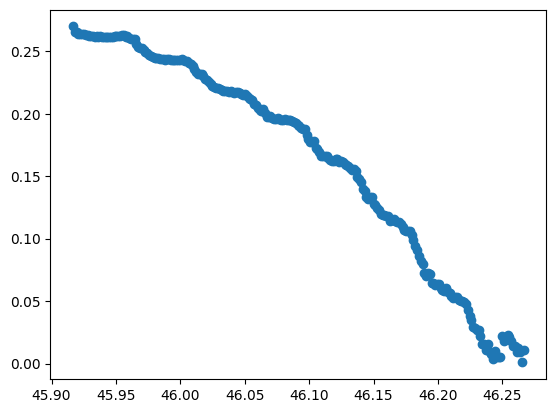

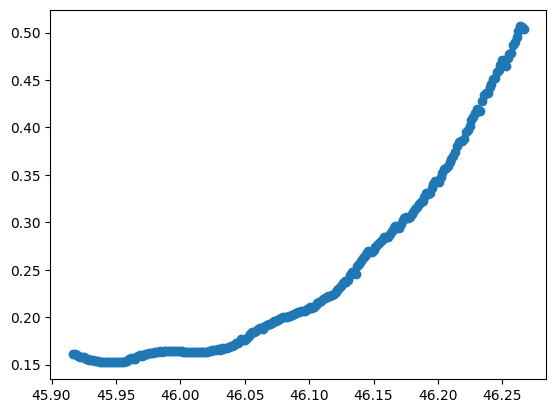

In [62]:
plt.scatter(kp_df['time'], kp_df['NOSE_X'])
# plt.ylim([0,1])
plt.show()
plt.scatter(kp_df['time'], kp_df['NOSE_Y'])
# plt.ylim([0,1])

## Testing Grounds

In [8]:
import pandas as pd
import os
from ast import literal_eval

In [5]:
file = 'movenet_poses.csv'

def read_movenet_kps(file):
    raw_df = pd.read_csv(file)

    for kp in keypoints:
        raw_df[kp] = raw_df[kp].apply(lambda x: literal_eval(x))

    return raw_df
    

'[0.2697855234146118, 0.16147059202194214, 0.511995792388916, 45.916666666666664]'

In [13]:
test1 = raw_df.iloc[0]['NOSE']
test2 = literal_eval(raw_df.iloc[0]['NOSE'])

print(type(test1))

print(type(test2))
print(test2[0])

<class 'str'>
<class 'list'>
0.2697855234146118


In [15]:
from movenet_utils import *

for kp in keypoints:
    raw_df[kp] = raw_df[kp].apply(lambda x: literal_eval(x))

2023-06-09 14:55:12.695377: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [20]:
raw_df['time'] = raw_df.apply(lambda row: row['NOSE'][-1], axis=1)

In [21]:
raw_df

,NOSE,LEFT_EYE,RIGHT_EYE,LEFT_EAR,RIGHT_EAR,LEFT_SHOULDER,RIGHT_SHOULDER,LEFT_ELBOW,RIGHT_ELBOW,LEFT_WRIST,RIGHT_WRIST,LEFT_HIP,RIGHT_HIP,LEFT_KNEE,RIGHT_KNEE,LEFT_ANKLE,RIGHT_ANKLE,time
0,"[0.2697855234146118, 0.16147059202194214, 0.51...","[0.2620418965816498, 0.16570553183555603, 0.58...","[0.2602092921733856, 0.15628212690353394, 0.45...","[0.2684589624404907, 0.17092889547348022, 0.46...","[0.26306936144828796, 0.1456352323293686, 0.54...","[0.3058744966983795, 0.17451518774032593, 0.41...","[0.30898517370224, 0.13661153614521027, 0.4377...","[0.3536026179790497, 0.19186821579933167, 0.40...","[0.3471733331680298, 0.12534284591674805, 0.40...","[0.38939109444618225, 0.19096654653549194, 0.4...","[0.38680750131607056, 0.12735991179943085, 0.2...","[0.4075305759906769, 0.17202496528625488, 0.46...","[0.40992027521133423, 0.14465124905109406, 0.4...","[0.4878115653991699, 0.16819719970226288, 0.46...","[0.49014726281166077, 0.1456911563873291, 0.50...","[0.5619070529937744, 0.1675514280796051, 0.407...","[0.5547682642936707, 0.1401493102312088, 0.354...",45.916667
1,"[0.2663668394088745, 0.15975065529346466, 0.49...","[0.259829044342041, 0.16392455995082855, 0.568...","[0.2579076588153839, 0.15474992990493774, 0.40...","[0.26752322912216187, 0.16980454325675964, 0.4...","[0.262299120426178, 0.14501428604125977, 0.528...","[0.3067312240600586, 0.17325516045093536, 0.41...","[0.3086646795272827, 0.13579294085502625, 0.42...","[0.35677337646484375, 0.19057334959506989, 0.4...","[0.35071319341659546, 0.12766072154045105, 0.3...","[0.39321327209472656, 0.18839578330516815, 0.3...","[0.39030197262763977, 0.12457065284252167, 0.2...","[0.40987974405288696, 0.17005953192710876, 0.4...","[0.41159650683403015, 0.14394409954547882, 0.4...","[0.48849883675575256, 0.16743460297584534, 0.4...","[0.49092796444892883, 0.14417767524719238, 0.4...","[0.5631393790245056, 0.16748060286045074, 0.44...","[0.5557327270507812, 0.13932570815086365, 0.37...",45.960417
2,"[0.26750341057777405, 0.15862397849559784, 0.4...","[0.2618328630924225, 0.1628614217042923, 0.571...","[0.2616244852542877, 0.15466567873954773, 0.50...","[0.2685219347476959, 0.16917476058006287, 0.48...","[0.2650730311870575, 0.14524459838867188, 0.51...","[0.30791494250297546, 0.17194610834121704, 0.4...","[0.30911144614219666, 0.13513655960559845, 0.4...","[0.35125458240509033, 0.1893903613090515, 0.38...","[0.3511311113834381, 0.12754929065704346, 0.29...","[0.3925136923789978, 0.18807706236839294, 0.40...","[0.39099371433258057, 0.12463328242301941, 0.2...","[0.40956416726112366, 0.16876189410686493, 0.5...","[0.41163650155067444, 0.1434878557920456, 0.42...","[0.48466756939888, 0.1665937602519989, 0.45698...","[0.4864005446434021, 0.1437453180551529, 0.456...","[0.5609728693962097, 0.16627731919288635, 0.43...","[0.5581004619598389, 0.141171395778656, 0.4473...",46.004167
3,"[0.2660023868083954, 0.1569090038537979, 0.433...","[0.2604833245277405, 0.1611209362745285, 0.544...","[0.2610243558883667, 0.15312005579471588, 0.53...","[0.2677832245826721, 0.1674359142780304, 0.491...","[0.2644626796245575, 0.14409810304641724, 0.51...","[0.306500107049942, 0.17051029205322266, 0.426...","[0.3079410791397095, 0.13457560539245605, 0.39...","[0.3498046100139618, 0.18760354816913605, 0.37...","[0.3504859507083893, 0.12731830775737762, 0.28...","[0.3895733058452606, 0.18759611248970032, 0.40...","[0.38984453678131104, 0.12552089989185333, 0.2...","[0.408382773399353, 0.16850614547729492, 0.517...","[0.41109296679496765, 0.1436159759759903, 0.43...","[0.4846769869327545, 0.16681626439094543, 0.45...","[0.48608922958374023, 0.1441081017255783, 0.46...","[0.5600618720054626, 0.1667739301919937, 0.428...","[0.5568675994873047, 0.14173580706119537, 0.44...",46.047917
4,"[0.264798641204834, 0.15730467438697815, 0.448...","[0.25858062505722046, 0.16136789321899414, 0.5...","[0.2576316297054291, 0.15317746996879578, 0.49...","[0.2662627398967743, 0.1671985536813736, 0.509...","[0.261923104524612

In [22]:
print(raw_df.iloc[0]['NOSE'])

for kp in keypoints:
    raw_df[kp] = raw_df[kp].apply(lambda x: [-1*x[1]+1, x[0], x[2], x[3]])

print(raw_df.iloc[0]['NOSE'])

[0.2697855234146118, 0.16147059202194214, 0.511995792388916, 45.916666666666664]
[0.8385294079780579, 0.2697855234146118, 0.511995792388916]
